In [24]:
from PIL import Image, ImageOps
from collections import Counter
from shutil import copyfile
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import pickle
import zipfile
import os, sys
import scipy.io
from scipy.ndimage import interpolation

In [32]:
%%capture

# check if this is a colab notebook and clone the repo if it is
if 'COLAB_GPU' in os.environ:
    %cd /content/
    !git clone https://github.com/simonsanvil/ECG-classification-MLH.git
    %cd ECG-classification-MLH
else:
    os.chdir('..')

!pip install -r requirements.txt

!pip install -e .

In [33]:
%ls

app/        LICENSE     README.md         setup.py
data/       Makefile    references/       src/
Dockerfile  models/     reports/          src.egg-info/
docs/       notebooks/  requirements.txt  test_environment.py


In [34]:
class ECGSignalReader:
  def __init__(self,image_path,crop_xs,crop_ys, r):
    self.path = image_path
    self.crop_xs = crop_xs
    self.crop_ys = crop_ys
    self.r = r

  def image(self, to_gray=True, show=True):
    if to_gray:
      im = Image.open(self.path).convert('L')
    else:
      im = Image.open(self.path)
    if show:
      display(im)
    return im

  def crop_images(self,show=True):
    im = self.image(show=False)
    cx = self.crop_xs
    r = self.r
    ims = []
    for i,cy in enumerate(self.crop_ys):
      crop = im.crop((cx[0], cy[0], cx[1], cy[1]))
      w, h = (cx[1]-cx[0], cy[1]-cy[0])
      crop_resized = crop.resize((w+int(w*r), h+int(h*r)))
      if show:
        print(f"\nCropped image number {i}:")
        display(crop)
        display(crop_resized)
      ims.append(np.array(crop_resized))
    return ims

  def raw_sequence(self, inds_mv):
    zero_ind = 73+int(73*self.r)
    sequence = []
    crop_ims = self.crop_images(show=False)
    for im in crop_ims:
      min_inds = np.argmin(im,axis=0)
      crop_signal = inds_mv*np.array([zero_ind-i for i in min_inds]) #inds_mv*648
      sequence = np.concatenate((sequence,crop_signal))
    return sequence

  def sequence(self, inds_mv, n_interp=9000, round=False):
    #remove first values (no-info), round and interpolate to have 'n_interp' points
    raw_sequence = self.raw_sequence(inds_mv)
    new_start = 40+int(self.r*40)
    z = n_interp / len(raw_sequence[new_start:])
    if round:
      return interpolation.zoom(raw_sequence[new_start:].round(),z)
    return interpolation.zoom(raw_sequence[new_start:],z)

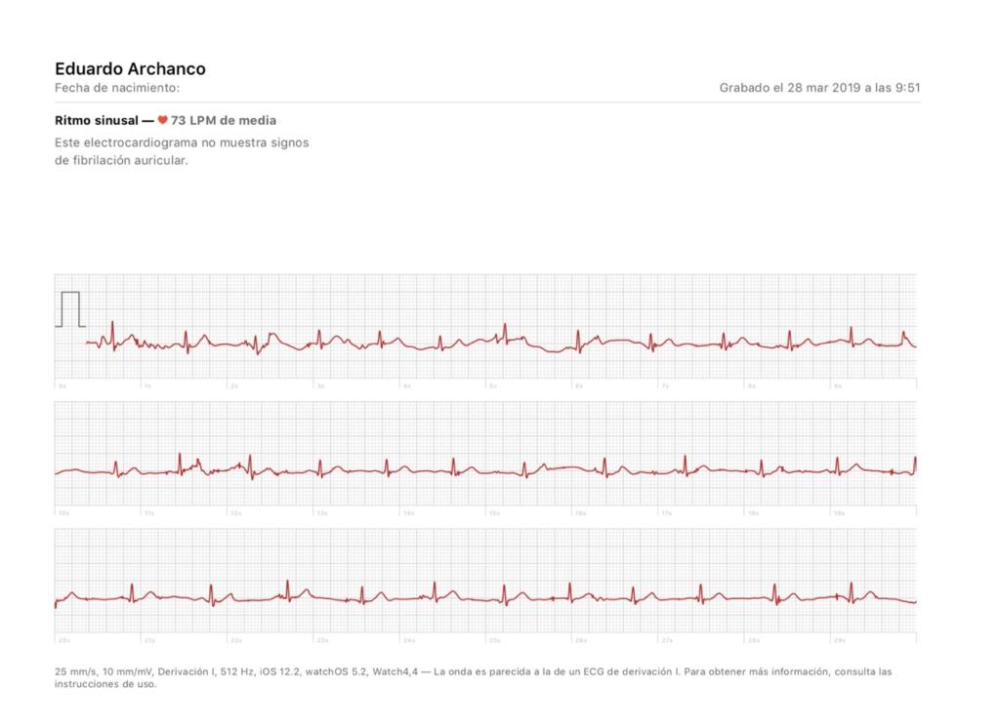

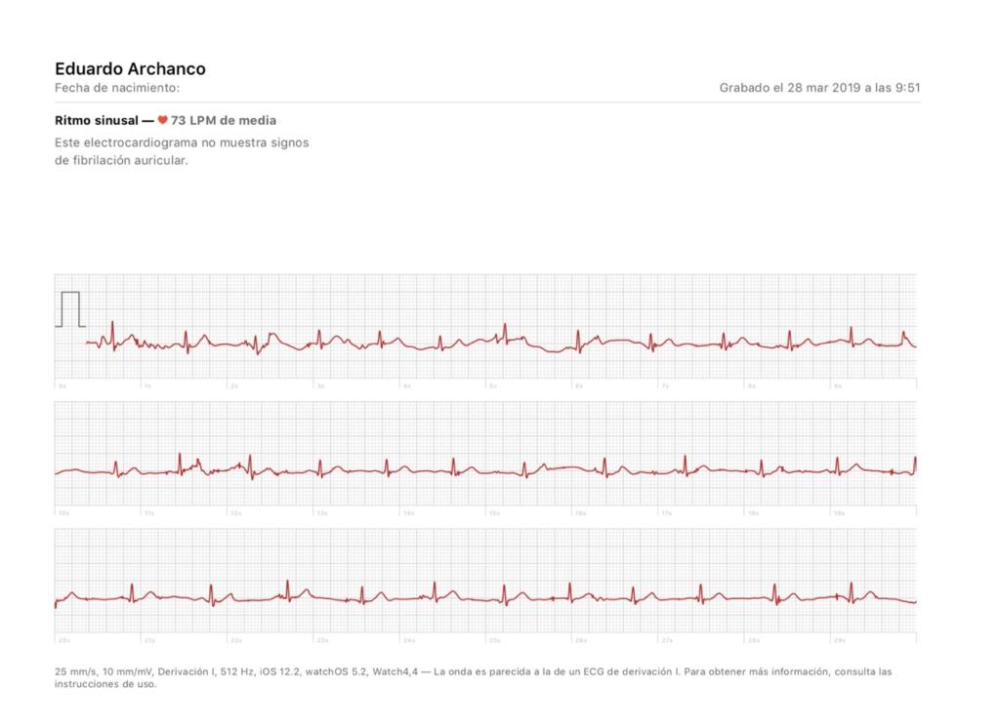

In [35]:
drive_path = 'data/pdf2seq/'# change if neccesary
ecg_reader = ECGSignalReader(drive_path+'signal.png', (56,898), [(280,390),(410,520),(540,650)], 20)
ecg_reader.image(to_gray=False)

(2310, 17682)


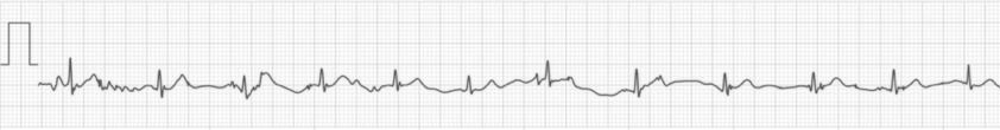

(2310, 17682)


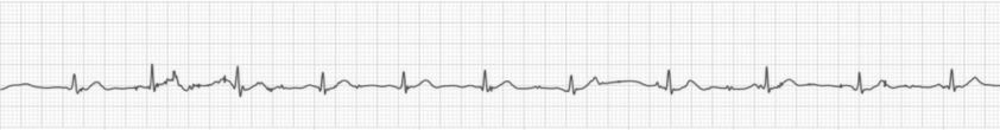

(2310, 17682)


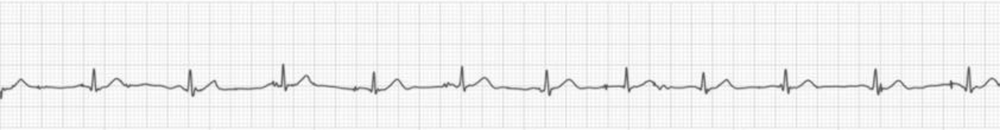

In [36]:
crop_ims = ecg_reader.crop_images(show=False)
for i in crop_ims:
  print(i.shape)
  display(Image.fromarray(i))

(2310, 17682)
Original signal


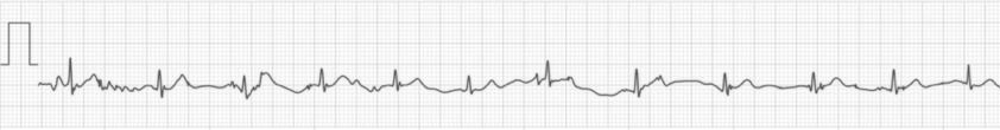



Signal with red points in the pixels with the minimum value per column:


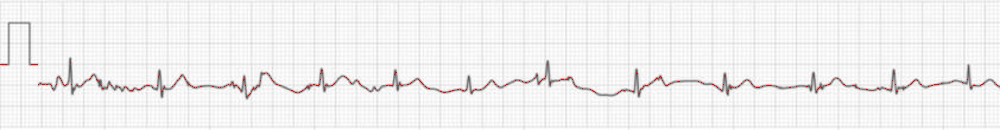

In [37]:
#showing that the sequence fits with pixels with the minimum value per column
im = np.array(crop_ims[0])
print(im.shape)
print("Original signal")
display(Image.fromarray(im))
I = np.dstack([im, im, im])
min_inds = np.argmin(im,axis=0)
for col in range(im.shape[1]):
  for i in range(-2,3):
    for j in range(-2,3):
      try:
        I[min_inds[col]+i,col+j,:] = [255, 0, 0]
      except:
        pass
print("\n\nSignal with red points in the pixels with the minimum value per column:")
display(Image.fromarray(I))

ECG signal with vertical black line in the 35th col with a length of 418 pixels


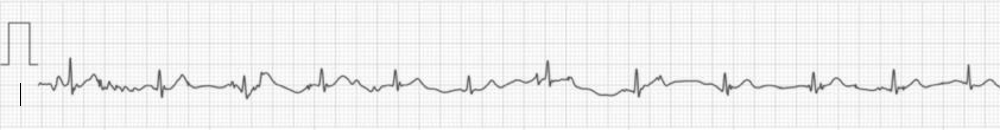


- 1 mV equivals to 418 indixes
- 1 index equival to 0.0023923444976076554 mVs



In [40]:
# showing the relation between pixels indices and mvs in the ecg signal 
im = np.array(crop_ims[0])
line_start_y = 72+(70*ecg_reader.r)
line_end_y = 90+(90*ecg_reader.r)
line_x = 17+(17*ecg_reader.r)
for i in range(line_start_y,line_end_y):
  for j in range(15):
    im[i,line_x+j] = 0

length_line = line_end_y - line_start_y
print("ECG signal with vertical black line in the 35th col with a length of", length_line, "pixels")
display(Image.fromarray(im))
print("\n- 1 mV equivals to", length_line, "indixes")
print("- 1 index equival to", 1/length_line, "mVs\n")

Sequence obtained from the image:


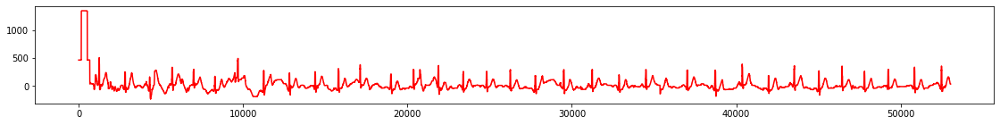

Sequence obtained after removing the first indices and interpolating to 9000 pxs>:


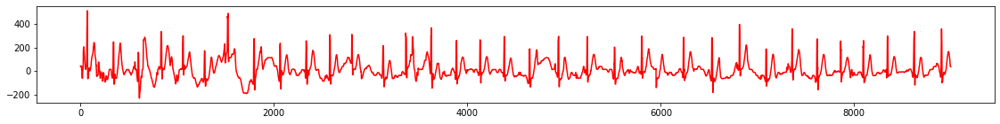

In [41]:
# therefore, we can adjust the value of inds_mv
inds_mv = 1.2 #(this value has been adjusted by posterior analysis)
raw_ecg_seq = ecg_reader.raw_sequence(inds_mv)
ecg_seq = ecg_reader.sequence(inds_mv)

print("Sequence obtained from the image:")
plt.figure(figsize=(19.25, 2))
plt.plot(raw_ecg_seq, color ="red")
plt.show()
print("Sequence obtained after removing the first indices and interpolating to 9000 pxs>:")
plt.figure(figsize=(19.25, 2))
plt.plot(ecg_seq, color ="red")
plt.show()

In [21]:
## in case load data is needed
# zipPath='./training2017.zip' #TO-DO:change appropiately
# copyfile(drive_path+'/training2017.zip', zipPath) #Copy data file to our working folder
# dataFolder='./data' #We extract files to the current folder
# with zipfile.ZipFile(zipPath, 'r') as zip_ref:
#     zip_ref.extractall(dataFolder)

In [43]:
# read an example of signal from database
mat_s = scipy.io.loadmat('data/pdf2seq/example_ecg.mat')["val"][0]

signal from database:


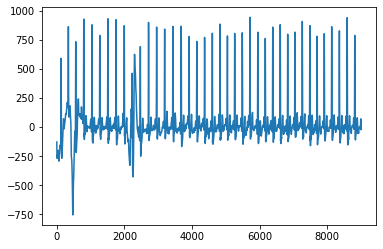


signal generated from image:


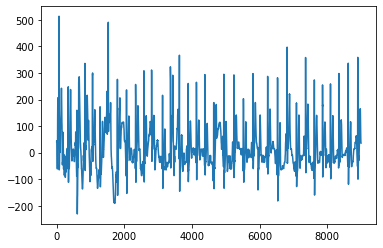


both signals combined:


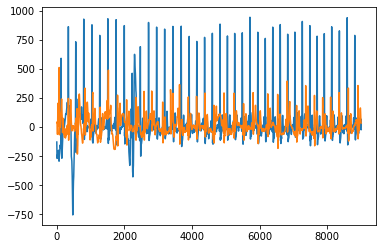

In [44]:
print("signal from database:")
plt.plot(mat_s)
plt.show()
print("\nsignal generated from image:")
plt.plot(ecg_seq)
plt.show()
print("\nboth signals combined:")
plt.plot(mat_s)
plt.plot(ecg_seq);

In [56]:
## adjust inds_mv parameter by computing different comparison of boxplots
# for i in range(50,700,50):
#   ecg_seq = ecg_reader.sequence(i*inds_mv)
#   plt.figure(figsize=(19.25, 4))
#   seqs = pd.DataFrame({"signal":np.concatenate((mat_s, ecg_seq)), "class":["database"]*len(mat_s)+["generated"]*len(ecg_seq)})
#   ax = sns.boxplot(y="class", x="signal",data=seqs)
#   plt.show()

signal from database:
mean: 18.569444444444443  median: -3.0,  max: 946  min: -754,  stand dev: 168.31798101517464  var: 28330.94273302469

signal generated from image:
mean: 14.974117074661141  median: -1.2007980953649111,  max: 513.7017543439811  min: -230.72977564889345,  stand dev: 81.27888933552579  var: 6606.257851616649


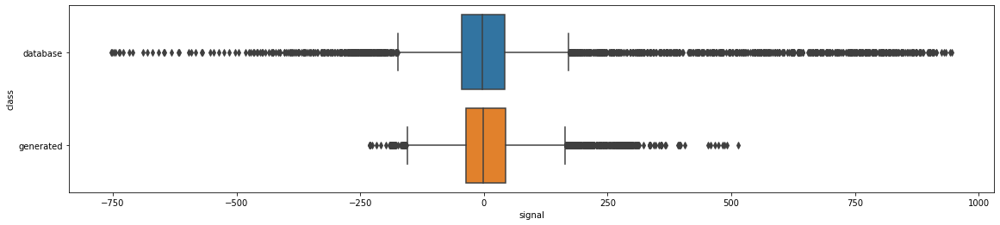

In [45]:
print("signal from database:")
plt.figure(figsize=(19.25, 4))
seqs = pd.DataFrame({"signal":np.concatenate((mat_s, ecg_seq)), "class":["database"]*len(mat_s)+["generated"]*len(ecg_seq)})
ax = sns.boxplot(y="class", x="signal",data=seqs)
for i, s in enumerate([mat_s, ecg_seq]):
  print("mean:", s.mean(), " median:",np.median(s), end=", ")
  print(" max:", s.max(), " min:", s.min(), end=", ")
  print(" stand dev:", s.std(), " var:",s.var())
  if i==0:
    print("\nsignal generated from image:")

In [94]:
# save the signal generated in a mat file
mdic = {"val": ecg_seq, "label": "experiment"}
scipy.io.savemat(drive_path+"data/pdf2seq/experiment_ecg.mat", mdic)